# Marianna Beaute

## 311_Service_Requests_from_2022 from NYC Open Data

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import math
import matplotlib.pyplot as plt
import datetime as dt
import plotly.express as px
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

In [2]:
requests = pd.read_csv('Data/311ServiceRequests2022new.csv')

# Data Cleaning

In [3]:
requests.head(10)

,Unique Key,Created Date,Closed Date,Complaint Type,Descriptor,Location Type,IncidentZip,Status,Open Data Channel Type,Latitude,Longitude
0,53970157,4/21/22 0:55,1/12/23 0:00,General Construction/Plumbing,Sidewalk Shed/Pipe Scafford - Inadequate Defec...,NaN,11207,Closed,UNKNOWN,40.677434,-73.898880
1,55337224,9/8/22 8:46,1/12/23 0:00,Building/Use,Illegal Conversion Of Residential Building/Space,NaN,11201,Closed,UNKNOWN,40.691776,-73.997245
2,53983608,4/22/22 11:22,2/16/23 20:25,GENERAL,MAILBOX,RESIDENTIAL BUILDING,11221,Closed,PHONE,40.688590,-73.918256
3,54034149,4/28/22 14:23,7/31/22 0:00,Traffic Signal Condition,Controller,NaN,11208,Closed,UNKNOWN,40.659414,-73.870791
4,54158369,5/13/22 13:32,2/22/23 12:30,Uprooted Stump,Remove Stump,Street,11221,Closed,PHONE,40.684535,-73.939076
5,54227181,5/20/22 11:55,2/27/23 12:06,Adopt-A-Basket,Adopt-A-Basket,Sidewalk,11226,Closed,PHONE,40.636040,-73.962241
6,54394482,5/17/22 9:25,2/2/23 0:00,BEST/Site Safety,Demolition - Unsafe,NaN,11221,Closed,UNKNOWN,40.684869,-73.942825
7,56388620,12/28/22 12:47,12/30/22 13:32,Street Light Condition,Street Light Dayburning,NaN,11201,Closed,UNKNOWN,40.691194,-73.997768
8,54430117,6/8/22 9:00,2/2/23 0:00,Building/Use,Illegal Conversion Of Residential Building/Space,NaN,11221,Closed,UNKNOWN,40.692987,-73.910422
9,54603380,6/26/22 0:01,2/16/23 12:46,UNSANITARY CONDITION,GARBAGE/RECYCLING STORAGE,RESIDENTIAL BUILDING,11208,Closed,ONLINE,40.669575,-73.881478


In [4]:
requests = requests.rename(columns={'IncidentZip': 'Incident Zip'})

In [5]:
requests.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 183683 entries, 0 to 183682
Data columns (total 11 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   Unique Key              183683 non-null  int64  
 1   Created Date            183683 non-null  object 
 2   Closed Date             176691 non-null  object 
 3   Complaint Type          183683 non-null  object 
 4   Descriptor              181161 non-null  object 
 5   Location Type           161633 non-null  object 
 6   Incident Zip            183683 non-null  int64  
 7   Status                  183683 non-null  object 
 8   Open Data Channel Type  183683 non-null  object 
 9   Latitude                182920 non-null  float64
 10  Longitude               182920 non-null  float64
dtypes: float64(2), int64(2), object(7)
memory usage: 15.4+ MB


In [6]:
requests.isnull().sum()

Unique Key                    0
Created Date                  0
Closed Date                6992
Complaint Type                0
Descriptor                 2522
Location Type             22050
Incident Zip                  0
Status                        0
Open Data Channel Type        0
Latitude                    763
Longitude                   763
dtype: int64

In [7]:
requests['Created Date']  = pd.to_datetime(requests['Created Date'])

In [8]:
requests['Hour'] = requests['Created Date'].dt.strftime('%H')

In [9]:
requests['Hour'] = requests['Hour'].astype(int)
requests

,Unique Key,Created Date,Closed Date,Complaint Type,Descriptor,Location Type,Incident Zip,Status,Open Data Channel Type,Latitude,Longitude,Hour
0,53970157,2022-04-21 00:55:00,1/12/23 0:00,General Construction/Plumbing,Sidewalk Shed/Pipe Scafford - Inadequate Defec...,NaN,11207,Closed,UNKNOWN,40.677434,-73.898880,0
1,55337224,2022-09-08 08:46:00,1/12/23 0:00,Building/Use,Illegal Conversion Of Residential Building/Space,NaN,11201,Closed,UNKNOWN,40.691776,-73.997245,8
2,53983608,2022-04-22 11:22:00,2/16/23 20:25,GENERAL,MAILBOX,RESIDENTIAL BUILDING,11221,Closed,PHONE,40.688590,-73.918256,11
3,54034149,2022-04-28 14:23:00,7/31/22 0:00,Traffic Signal Condition,Controller,NaN,11208,Closed,UNKNOWN,40.659414,-73.870791,14
4,54158369,2022-05-13 13:32:00,2/22/23 12:30,Uprooted Stump,Remove Stump,Street,11221,Closed,PHONE,40.684535,-73.939076,13
...,...,...,...,...,...,...,...,...,...,...,...,...
183678,56410441,2022-12-31 12:41:00,1/19/23 7:34,UNSANITARY CONDITION,GARBAGE/RECYCLING STORAGE,RESIDENTIAL BUILDING,11208,Closed,ONLINE,40.667408,-73.882635,12
183679,56411923,2022-12-31 11:47:00,1/23/23 20:31,PLUMBING,TOILET,RESIDENTIAL BUILDING,11221,Closed,ONLINE,40.684013,-73.943612,11
183680,56411978,2022-12-31 05:16:00,1/18/23 20:16,WATER LEAK,DAMP SPOT,RESIDENTIAL BUILDING,11221,Closed,ONLINE,40.690804,-73.943361,5
183681,56412459,2022-12-31 08:37:00,1/6/23 0:00,General Construction/Plumbing,Failure To Maintain,NaN,11207,Closed,UNKNOWN,40.677712,-73.885490,8


In [10]:
requests['Time of Day'] = np.where(requests['Hour'] >= 12, 'PM', 'AM')

In [11]:
requests['Month'] = requests['Created Date'].dt.strftime('%B')
requests

,Unique Key,Created Date,Closed Date,Complaint Type,Descriptor,Location Type,Incident Zip,Status,Open Data Channel Type,Latitude,Longitude,Hour,Time of Day,Month
0,53970157,2022-04-21 00:55:00,1/12/23 0:00,General Construction/Plumbing,Sidewalk Shed/Pipe Scafford - Inadequate Defec...,NaN,11207,Closed,UNKNOWN,40.677434,-73.898880,0,AM,April
1,55337224,2022-09-08 08:46:00,1/12/23 0:00,Building/Use,Illegal Conversion Of Residential Building/Space,NaN,11201,Closed,UNKNOWN,40.691776,-73.997245,8,AM,September
2,53983608,2022-04-22 11:22:00,2/16/23 20:25,GENERAL,MAILBOX,RESIDENTIAL BUILDING,11221,Closed,PHONE,40.688590,-73.918256,11,AM,April
3,54034149,2022-04-28 14:23:00,7/31/22 0:00,Traffic Signal Condition,Controller,NaN,11208,Closed,UNKNOWN,40.659414,-73.870791,14,PM,April
4,54158369,2022-05-13 13:32:00,2/22/23 12:30,Uprooted Stump,Remove Stump,Street,11221,Closed,PHONE,40.684535,-73.939076,13,PM,May
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
183678,56410441,2022-12-31 12:41:00,1/19/23 7:34,UNSANITARY CONDITION,GARBAGE/RECYCLING STORAGE,RESIDENTIAL BUILDING,11208,Closed,ONLINE,40.667408,-73.882635,12,PM,December
183679,56411923,2022-12-31 11:47:00,1/23/23 20:31,PLUMBING,TOILET,RESIDENTIAL BUILDING,11221,Closed,ONLINE,40.684013,-73.943612,11,AM,December
183680,56411978,2022-12-31 05:16:00,1/18/23 20:16,WATER LEAK,DAMP SPOT,RESIDENTIAL BUILDING,11221,Closed,ONLINE,40.690804,-73.943361,5,AM,December
183681,56412459,2022-12-31 08:37:00,1/6/23 0:00,General Construction/Plumbing,Failure To Maintain,NaN,11207,Closed,UNKNOWN,40.677712,-73.885490,8,AM,December


In [12]:
requests.duplicated().sum()

0

In [13]:
requests.describe()

,Unique Key,Incident Zip,Latitude,Longitude,Hour
count,1.836830e+05,183683.000000,182920.000000,182920.000000,183683.000000
mean,5.470042e+07,11213.817958,40.673751,-73.927968,12.978583
std,1.015389e+06,9.627456,0.018661,0.040399,6.059259
min,5.293166e+07,11201.000000,40.634330,-74.001457,0.000000
25%,5.382684e+07,11207.000000,40.655086,-73.959834,9.000000
50%,5.469550e+07,11208.000000,40.678211,-73.929353,13.000000
75%,5.560024e+07,11226.000000,40.689704,-73.890485,18.000000
max,5.655161e+07,11417.000000,40.739290,-73.852875,23.000000


In [14]:
requests['Complaint Type'].unique()

array(['General Construction/Plumbing', 'Building/Use', 'GENERAL',
       'Traffic Signal Condition', 'Uprooted Stump', 'Adopt-A-Basket',
       'BEST/Site Safety', 'Street Light Condition',
       'UNSANITARY CONDITION', 'WATER LEAK', 'ELECTRIC', 'PLUMBING',
       'APPLIANCE', 'PAINT/PLASTER', 'Street Sign - Missing',
       'FLOORING/STAIRS', 'DOOR/WINDOW', 'For Hire Vehicle Complaint',
       'Overgrown Tree/Branches', 'Damaged Tree', 'Lot Condition',
       'SAFETY', 'New Tree Request', 'Dead/Dying Tree',
       'Root/Sewer/Sidewalk Condition', 'Noise - Helicopter',
       'Dirty Condition', 'Sidewalk Condition', 'Curb Condition',
       'Illegal Tree Damage', 'Illegal Dumping', 'Rodent',
       'Unsanitary Pigeon Condition', 'Missed Collection',
       'Illegal Posting', 'Illegal Parking', 'Taxi Complaint', 'Graffiti',
       'OUTSIDE BUILDING', 'Special Projects Inspection Team (SPIT)',
       'Elevator', 'Water System', 'Outdoor Dining', 'Indoor Sewage',
       'Wood Pile Remai

In [15]:
requests['Open Data Channel Type'].unique()

array(['UNKNOWN', 'PHONE', 'ONLINE', 'MOBILE', 'OTHER'], dtype=object)

In [16]:
requests['Incident Zip'].unique()

array([11207, 11201, 11221, 11208, 11226, 11416, 11385, 11417, 11414,
       11368])

In [17]:
requests['Location Type'].unique()

array([nan, 'RESIDENTIAL BUILDING', 'Street', 'Sidewalk', 'Lot',
       'Above Address', '3+ Family Apt. Building',
       '3+ Family Apartment Building', 'Other (Explain Below)',
       'Construction Site', 'Street/Sidewalk', 'Comercial',
       '3+ Family Mixed Use Building', '1-2 Family Mixed Use Building',
       'Park', 'Mixed Use', 'Highway', 'School', 'Residential',
       'Restaurant/Bar/Deli/Bakery', '1-2 Family Dwelling',
       'Food Cart Vendor', 'Catering Service', 'Commercial Building',
       'Street/Curbside', 'Soup Kitchen', 'Vacant Lot', 'Yard',
       'Mobile Food Vendor', 'Curb', 'Green Cart Vendor', 'Business',
       'Park/Playground', 'Cafeteria - College/University', 'Restaurant',
       'Loft Residence', 'Residential Building',
       'Correctional Facility - City', 'Residence', 'Other',
       'Residential Building/House', 'Store/Commercial', 'Taxi',
       'Club/Bar/Restaurant', 'Building (Non-Residential)',
       'Indoor Public Place', 'Public/Unfenced Area

# MAP OF SERVICE REQUESTS

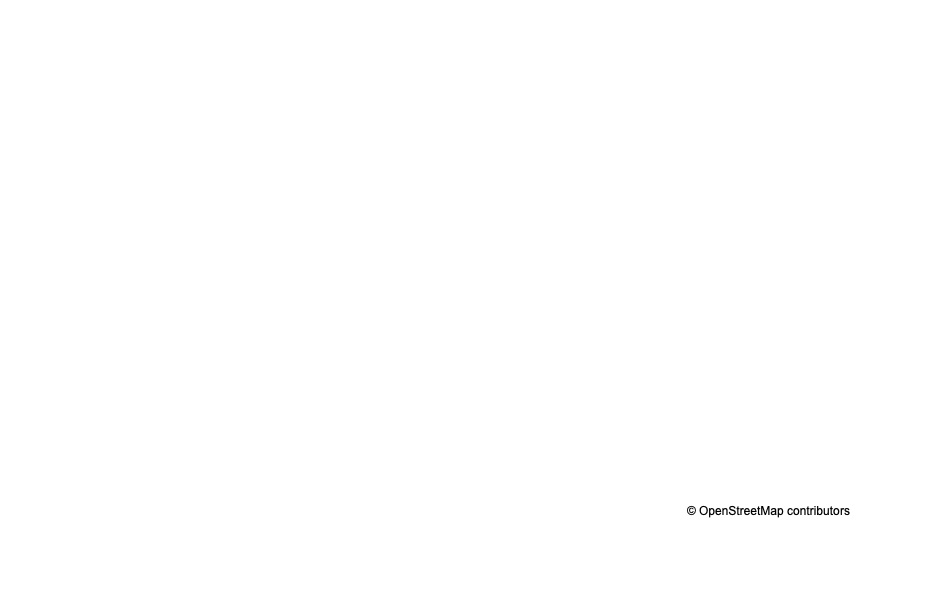

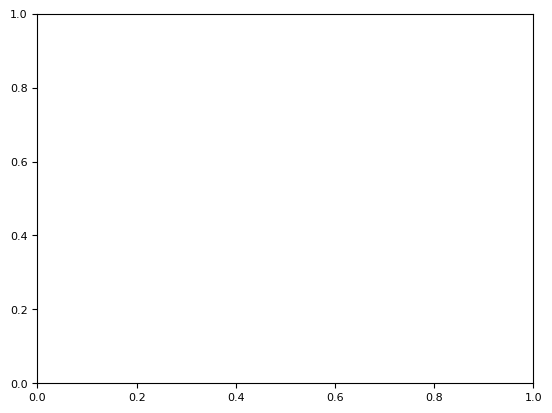

In [18]:
color_scale = [(0, 'orange'), (1,'red')]
fig = px.scatter_mapbox(requests,
                        lat="Latitude",
                        lon="Longitude",
                        hover_data=["Incident Zip", "Complaint Type"],
                        color_continuous_scale=color_scale,
                        zoom=9,
                        height=600,
                        width=600)
fig.update_layout(mapbox_style="open-street-map")
plt.tick_params(axis='both', which='major', labelsize=8)
fig.show()

# TIME: AM/PM, HOUR & MONTH

In [19]:
time = requests.pivot_table(index ='Time of Day', values = 'Unique Key', aggfunc = 'count')
time

,Unique Key
Time of Day,
AM,74458
PM,109225


In [20]:
timedf = time.reset_index()
timedf.rename(columns = {'Unique Key':'Service Requests'}, inplace = True)
timedf

,Time of Day,Service Requests
0,AM,74458
1,PM,109225


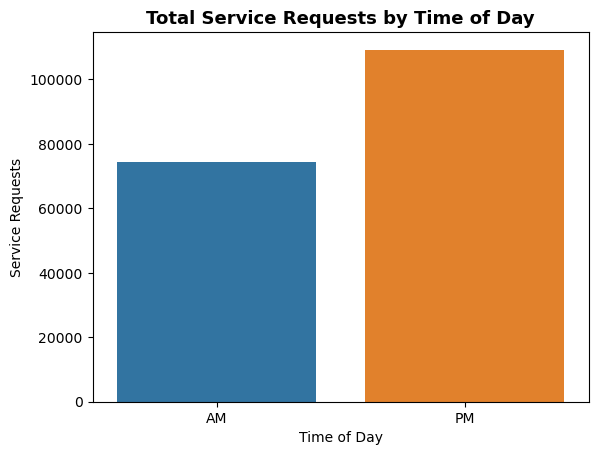

In [21]:
x1 = sns.barplot(x = 'Time of Day', y = 'Service Requests', data = timedf)
plt.title('Total Service Requests by Time of Day', fontsize=13, fontweight='bold')

plt.show()

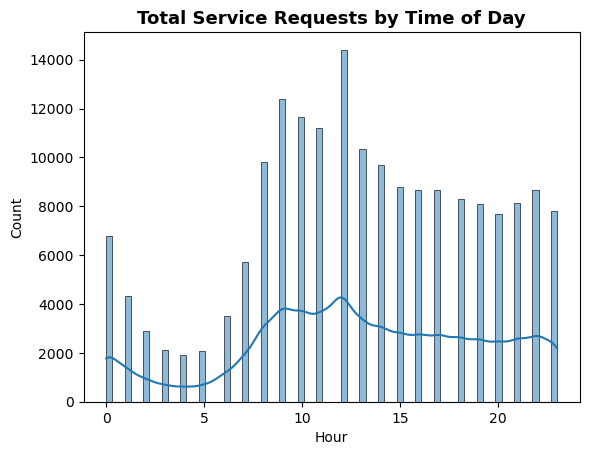

In [22]:
sns.histplot(data = requests, x= 'Hour', kde = 'true')
plt.title('Total Service Requests by Time of Day', fontsize=13, fontweight='bold')

plt.show()

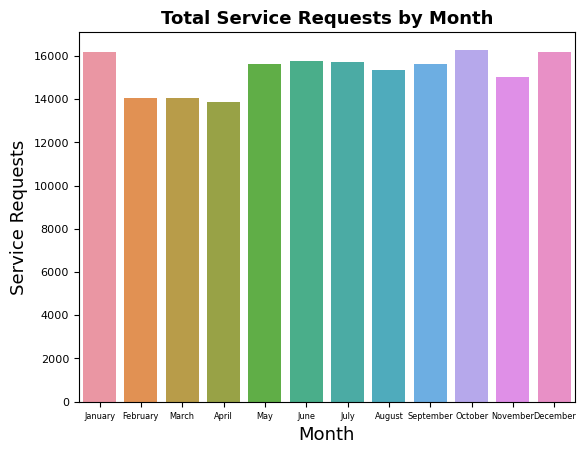

In [23]:
sns.countplot(data = requests, x = requests.sort_values('Created Date')['Created Date'].dt.strftime('%B'))
plt.title('Total Service Requests by Month', fontsize=13, fontweight='bold')
plt.xlabel('Month', fontsize= 13)
plt.ylabel('Service Requests', fontsize= 13)
plt.tick_params(axis='y', which='major', labelsize=8)
plt.tick_params(axis='x', which='major', labelsize=5.9)
plt.show()

In [24]:
monthrequests = requests.pivot_table(index ='Month', values = 'Unique Key', aggfunc = 'count')
monthrequests = monthrequests.sort_values(by = 'Unique Key', ascending = True)
monthrequestsdf = monthrequests.reset_index()
monthrequestsdf.rename(columns = {'Unique Key':'Service Requests'}, inplace = True)
monthrequestsdf

,Month,Service Requests
0,April,13851
1,February,14047
2,March,14057
3,November,15019
4,August,15350
5,September,15614
6,May,15618
7,July,15738
8,June,15743
9,December,16161


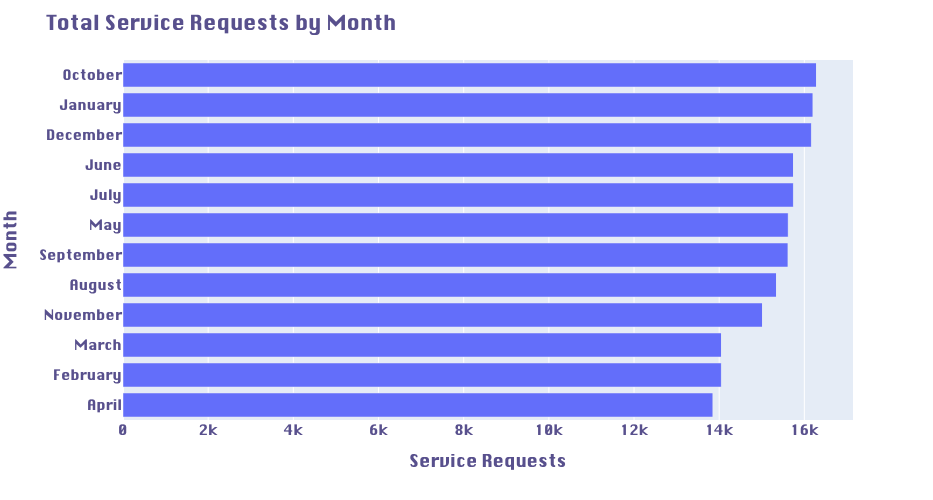

In [25]:
complaint_type_fig = px.bar(monthrequestsdf, x="Service Requests", y="Month", 
             orientation='h', height=500)
        

complaint_type_fig.update_layout(hovermode='x', title="Total Service Requests by Month",
                  font=dict(family="silom", size=14, color="#58508d"))

complaint_type_fig.show()

# METHOD OF REQUESTS

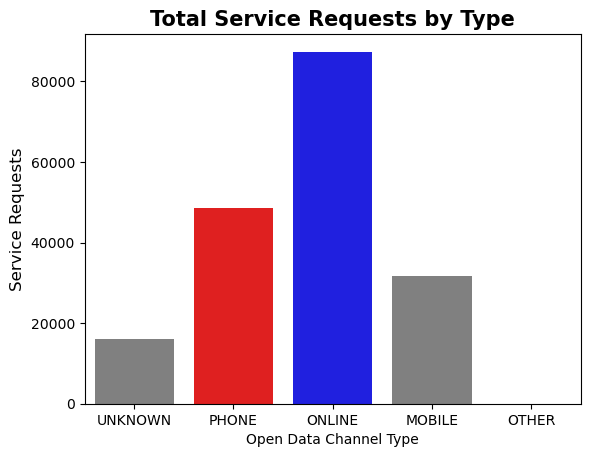

In [26]:
ax = sns.countplot(x = 'Open Data Channel Type', data = requests, palette = ["gray", "red", "blue"])
plt.title('Total Service Requests by Type', fontsize=15, fontweight='bold')
plt.ylabel('Service Requests', fontsize= 12)
plt.show()

# ZIP CODE

In [27]:
zip = requests
zip

,Unique Key,Created Date,Closed Date,Complaint Type,Descriptor,Location Type,Incident Zip,Status,Open Data Channel Type,Latitude,Longitude,Hour,Time of Day,Month
0,53970157,2022-04-21 00:55:00,1/12/23 0:00,General Construction/Plumbing,Sidewalk Shed/Pipe Scafford - Inadequate Defec...,NaN,11207,Closed,UNKNOWN,40.677434,-73.898880,0,AM,April
1,55337224,2022-09-08 08:46:00,1/12/23 0:00,Building/Use,Illegal Conversion Of Residential Building/Space,NaN,11201,Closed,UNKNOWN,40.691776,-73.997245,8,AM,September
2,53983608,2022-04-22 11:22:00,2/16/23 20:25,GENERAL,MAILBOX,RESIDENTIAL BUILDING,11221,Closed,PHONE,40.688590,-73.918256,11,AM,April
3,54034149,2022-04-28 14:23:00,7/31/22 0:00,Traffic Signal Condition,Controller,NaN,11208,Closed,UNKNOWN,40.659414,-73.870791,14,PM,April
4,54158369,2022-05-13 13:32:00,2/22/23 12:30,Uprooted Stump,Remove Stump,Street,11221,Closed,PHONE,40.684535,-73.939076,13,PM,May
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
183678,56410441,2022-12-31 12:41:00,1/19/23 7:34,UNSANITARY CONDITION,GARBAGE/RECYCLING STORAGE,RESIDENTIAL BUILDING,11208,Closed,ONLINE,40.667408,-73.882635,12,PM,December
183679,56411923,2022-12-31 11:47:00,1/23/23 20:31,PLUMBING,TOILET,RESIDENTIAL BUILDING,11221,Closed,ONLINE,40.684013,-73.943612,11,AM,December
183680,56411978,2022-12-31 05:16:00,1/18/23 20:16,WATER LEAK,DAMP SPOT,RESIDENTIAL BUILDING,11221,Closed,ONLINE,40.690804,-73.943361,5,AM,December
183681,56412459,2022-12-31 08:37:00,1/6/23 0:00,General Construction/Plumbing,Failure To Maintain,NaN,11207,Closed,UNKNOWN,40.677712,-73.885490,8,AM,December


In [28]:
ziptable = zip.pivot_table(index ='Incident Zip', values = 'Unique Key', aggfunc = 'count')
ziptable = ziptable.sort_values(by = 'Unique Key', ascending = True)
zipdf = ziptable.reset_index()
zipdf.rename(columns = {'Unique Key':'Service Requests'}, inplace = True)
zipdf

,Incident Zip,Service Requests
0,11368,1
1,11417,1
2,11416,3
3,11385,4
4,11414,4
5,11201,28816
6,11221,34116
7,11208,34236
8,11207,38563
9,11226,47939


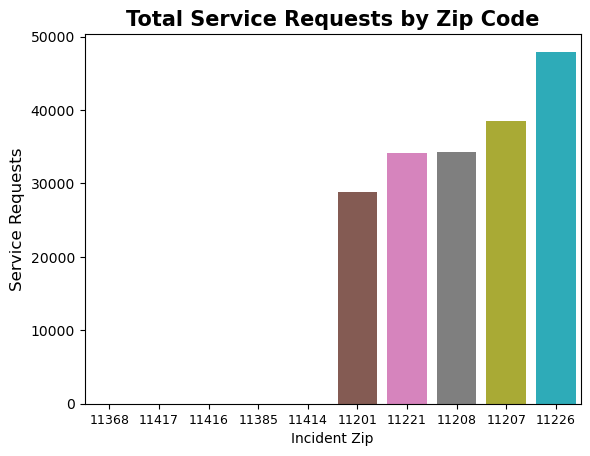

In [29]:
x = sns.countplot(x = 'Incident Zip', data = requests,  
                order=zipdf.sort_values('Service Requests', ascending = True)['Incident Zip'])
plt.title('Total Service Requests by Zip Code', fontsize=15, fontweight='bold')
plt.ylabel('Service Requests', fontsize= 12)
plt.tick_params(axis='x', labelsize=9)
plt.show()

# Top 10 Most Frequent Complaint Types

In [30]:
complaint_type = requests.pivot_table(index ='Complaint Type', values = 'Unique Key', aggfunc = 'count')
complaint_type = complaint_type.sort_values(by = 'Unique Key', ascending = True).tail(10)
complaint_typedf = complaint_type.reset_index()
complaint_typedf.rename(columns = {'Unique Key':'Service Requests'}, inplace = True)
complaint_typedf

,Complaint Type,Service Requests
0,General Construction/Plumbing,3576
1,Derelict Vehicles,3718
2,PAINT/PLASTER,4311
3,PLUMBING,4958
4,Noise - Street/Sidewalk,8070
5,UNSANITARY CONDITION,8599
6,Blocked Driveway,10125
7,HEAT/HOT WATER,16614
8,Noise - Residential,21597
9,Illegal Parking,24824


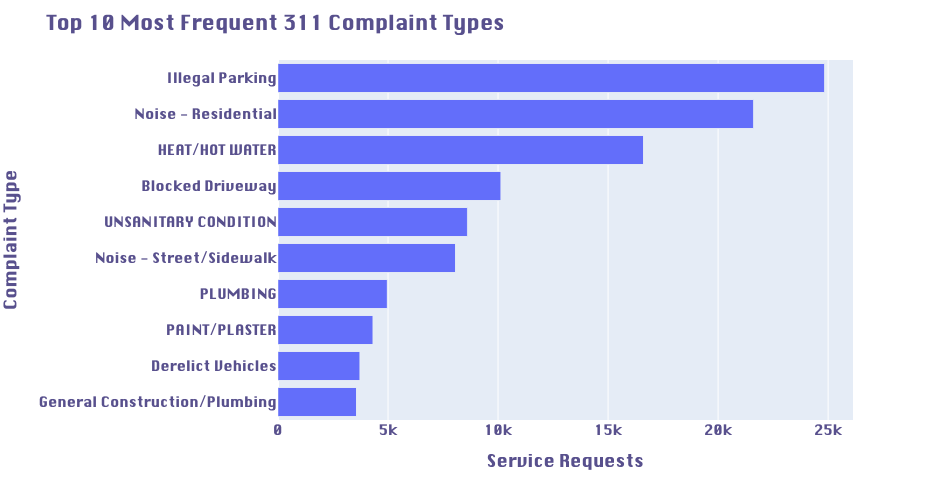

In [31]:
complaint_type_fig = px.bar(complaint_typedf, x="Service Requests", y="Complaint Type", 
             orientation='h', height=500)

complaint_type_fig.update_layout(hovermode='x', title="Top 10 Most Frequent 311 Complaint Types",
                  font=dict(family="silom", size=14, color="#58508d"))

complaint_type_fig.show()

# Top 5 Complaints of the Top 5 Zip Codes

In [32]:
ziptop = requests.rename(columns={'Incident Zip': 'IncidentZip'})
values = [11226.0, 11207.0, 11208.0, 11221.0, 11201.0]
ziptop = ziptop[ziptop.IncidentZip.isin(values) == True]
ziptop

,Unique Key,Created Date,Closed Date,Complaint Type,Descriptor,Location Type,IncidentZip,Status,Open Data Channel Type,Latitude,Longitude,Hour,Time of Day,Month
0,53970157,2022-04-21 00:55:00,1/12/23 0:00,General Construction/Plumbing,Sidewalk Shed/Pipe Scafford - Inadequate Defec...,NaN,11207,Closed,UNKNOWN,40.677434,-73.898880,0,AM,April
1,55337224,2022-09-08 08:46:00,1/12/23 0:00,Building/Use,Illegal Conversion Of Residential Building/Space,NaN,11201,Closed,UNKNOWN,40.691776,-73.997245,8,AM,September
2,53983608,2022-04-22 11:22:00,2/16/23 20:25,GENERAL,MAILBOX,RESIDENTIAL BUILDING,11221,Closed,PHONE,40.688590,-73.918256,11,AM,April
3,54034149,2022-04-28 14:23:00,7/31/22 0:00,Traffic Signal Condition,Controller,NaN,11208,Closed,UNKNOWN,40.659414,-73.870791,14,PM,April
4,54158369,2022-05-13 13:32:00,2/22/23 12:30,Uprooted Stump,Remove Stump,Street,11221,Closed,PHONE,40.684535,-73.939076,13,PM,May
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
183678,56410441,2022-12-31 12:41:00,1/19/23 7:34,UNSANITARY CONDITION,GARBAGE/RECYCLING STORAGE,RESIDENTIAL BUILDING,11208,Closed,ONLINE,40.667408,-73.882635,12,PM,December
183679,56411923,2022-12-31 11:47:00,1/23/23 20:31,PLUMBING,TOILET,RESIDENTIAL BUILDING,11221,Closed,ONLINE,40.684013,-73.943612,11,AM,December
183680,56411978,2022-12-31 05:16:00,1/18/23 20:16,WATER LEAK,DAMP SPOT,RESIDENTIAL BUILDING,11221,Closed,ONLINE,40.690804,-73.943361,5,AM,December
183681,56412459,2022-12-31 08:37:00,1/6/23 0:00,General Construction/Plumbing,Failure To Maintain,NaN,11207,Closed,UNKNOWN,40.677712,-73.885490,8,AM,December


In [33]:
topcomplaint = ziptop.pivot_table(index ='Complaint Type', values = 'Unique Key', aggfunc = 'count')
topcomplaint = topcomplaint.sort_values(by = 'Unique Key', ascending = True).tail(5)
topcomplaintdf = topcomplaint.reset_index()
topcomplaintdf.rename(columns = {'Unique Key':'Service Requests'}, inplace = True)
topcomplaintdf

,Complaint Type,Service Requests
0,UNSANITARY CONDITION,8599
1,Blocked Driveway,10125
2,HEAT/HOT WATER,16614
3,Noise - Residential,21597
4,Illegal Parking,24824


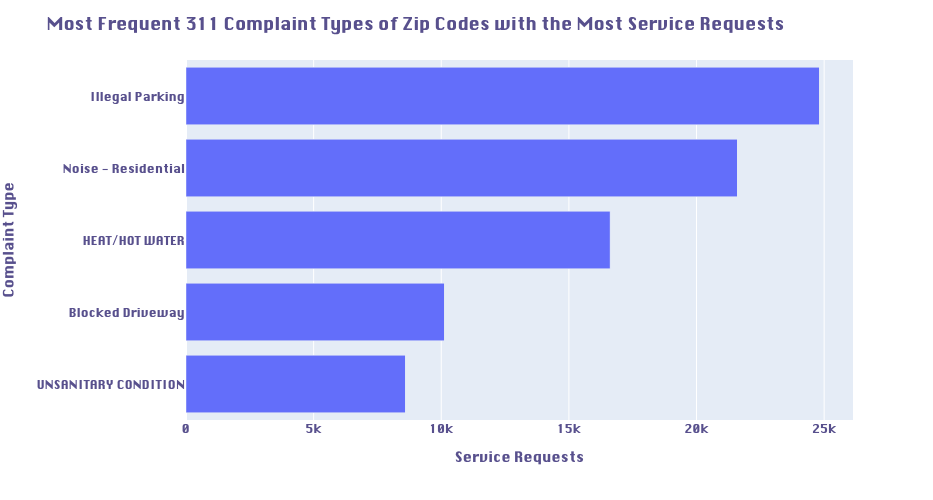

In [34]:
topcomplaint_type_fig = px.bar(topcomplaintdf, x="Service Requests", y="Complaint Type", 
             orientation='h', height=500)

topcomplaint_type_fig.update_layout(hovermode='x', title="Most Frequent 311 Complaint Types of Zip Codes with the Most Service Requests ",
                  font=dict(family="silom", size=12, color="#58508d"))

topcomplaint_type_fig.show()

# Top Complaint of Bottom 5 Zip Codes

In [35]:
zipbottom = requests.rename(columns={'Incident Zip': 'IncidentZip'})
values =  [11385, 11414, 11416, 11368, 11417]
zipbottom = zipbottom[zipbottom.IncidentZip.isin(values) == True]
zipbottom

,Unique Key,Created Date,Closed Date,Complaint Type,Descriptor,Location Type,IncidentZip,Status,Open Data Channel Type,Latitude,Longitude,Hour,Time of Day,Month
8122,53024566,2022-01-11 20:40:00,1/14/22 0:00,Request Large Bulky Item Collection,Request Large Bulky Item Collection,Sidewalk,11416,Closed,PHONE,NaN,NaN,20,PM,January
14888,53147464,2022-01-23 11:41:00,1/25/22 0:00,Request Large Bulky Item Collection,Request Large Bulky Item Collection,Sidewalk,11416,Closed,PHONE,NaN,NaN,11,AM,January
17199,53190612,2022-01-26 12:10:00,1/27/22 11:25,Street Condition,Pothole,NaN,11385,Closed,UNKNOWN,NaN,NaN,12,PM,January
34843,53515357,2022-03-03 08:30:00,3/8/22 0:00,Request Large Bulky Item Collection,Request Large Bulky Item Collection,Sidewalk,11417,Closed,PHONE,NaN,NaN,8,AM,March
43835,53719999,2022-03-22 16:47:00,3/29/22 4:00,Noise,Noise: Construction Before/After Hours (NM1),NaN,11385,Closed,ONLINE,NaN,NaN,16,PM,March
61624,54057413,2022-05-01 21:41:00,5/25/22 11:00,Street Condition,Pothole,NaN,11385,Closed,UNKNOWN,40.701046,-73.910678,21,PM,May
68946,54195667,2022-05-17 11:44:00,6/7/22 15:25,Street Condition,Pothole,NaN,11385,Closed,UNKNOWN,NaN,NaN,11,AM,May
89194,54583519,2022-06-24 07:21:00,6/24/22 22:30,Street Condition,Pothole,NaN,11414,Closed,UNKNOWN,NaN,NaN,7,AM,June
96620,54729421,2022-07-08 12:49:00,7/13/22 9:00,Street Condition,Pothole,NaN,11414,Closed,UNKNOWN,NaN,NaN,12,PM,July
96667,54730270,2022-07-08 12:53:00,7/8/22 12:53,Street Condition,Pothole,NaN,11414,Closed,UNKNOWN,NaN,NaN,12,PM,July


In [36]:
botttomcomplaint = zipbottom.pivot_table(index ='Complaint Type', values = 'Unique Key', aggfunc = 'count')
botttomcomplaint = botttomcomplaint.sort_values(by = 'Unique Key', ascending = True).tail(10)
botttomcomplaintdf = botttomcomplaint.reset_index()
botttomcomplaintdf.rename(columns = {'Unique Key':'Service Requests'}, inplace = True)
botttomcomplaintdf

,Complaint Type,Service Requests
0,For Hire Vehicle Complaint,1
1,Noise,1
2,Street Light Condition,1
3,Request Large Bulky Item Collection,3
4,Street Condition,7


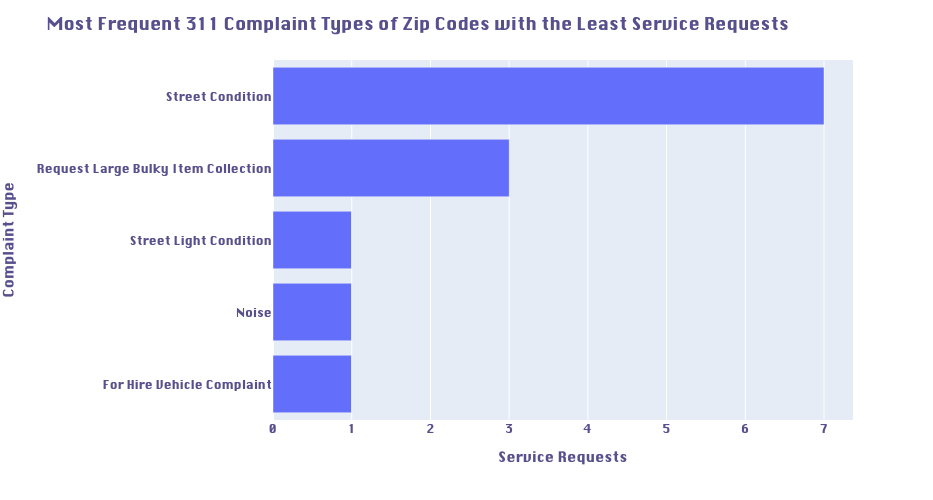

In [37]:
botttomcomplaint_type_fig = px.bar(botttomcomplaintdf, x="Service Requests", y="Complaint Type", 
             orientation='h', height=500)

botttomcomplaint_type_fig.update_layout(hovermode='x', title="Most Frequent 311 Complaint Types of Zip Codes with the Least Service Requests",
                  font=dict(family="silom", size=12, color="#58508d"))

botttomcomplaint_type_fig.show()

# Total Service Requests and Household Income

In [38]:
income = pd.read_excel('Data/ZipCodeIncome.xlsx')

In [39]:
income

,Incident Zip,Median,Mean
0,11226,66173,88051
1,11207,45616,63245
2,11208,49679,70501
3,11221,66923,92568
4,11201,148282,213208
5,11385,77350,94274
6,11414,86113,113435
7,11416,76477,97553
8,11368,62254,79303
9,11417,78498,95069


In [40]:
incomezip= pd.merge(zipdf, income, how='inner', on = 'Incident Zip')
incomezip

,Incident Zip,Service Requests,Median,Mean
0,11368,1,62254,79303
1,11417,1,78498,95069
2,11416,3,76477,97553
3,11385,4,77350,94274
4,11414,4,86113,113435
5,11201,28816,148282,213208
6,11221,34116,66923,92568
7,11208,34236,49679,70501
8,11207,38563,45616,63245
9,11226,47939,66173,88051


In [41]:
incomezip = incomezip.reset_index()

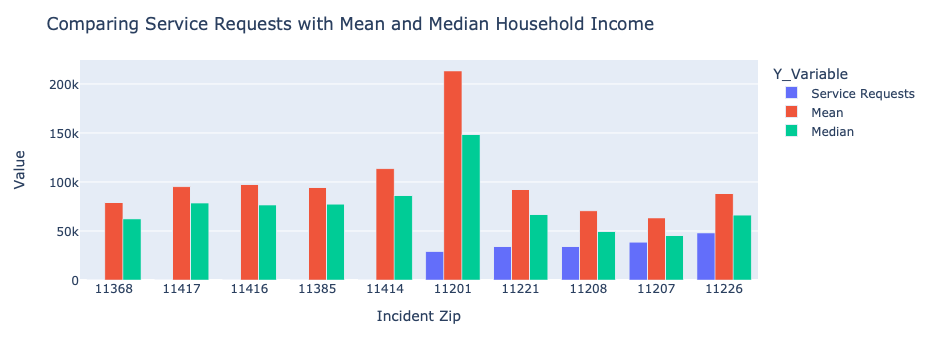

In [42]:
df = pd.DataFrame(incomezip)
df['Incident Zip'] = df['Incident Zip'].astype(str)

# Melt the DataFrame to transform the y variables into a single column
melted_df = incomezip.melt(id_vars='Incident Zip', value_vars=['Service Requests', 'Mean ', 'Median '], var_name='Y_Variable', value_name='Value')


fig = px.bar(melted_df, x='Incident Zip', y='Value', color='Y_Variable', barmode='group',
             labels={'X': 'X Variable', 'Value': 'Value'})
fig.update_layout(title='Comparing Service Requests with Mean and Median Household Income')
fig.show()


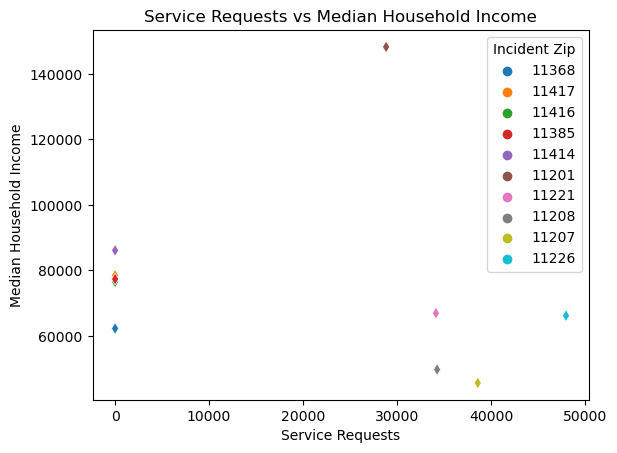

In [43]:
ax = sns.scatterplot(x='Service Requests', y='Median ', data=incomezip, hue='Incident Zip', marker="d")
plt.title("Service Requests vs Median Household Income")
plt.ylabel("Median Household Income") 
plt.show()

# Service Requests Status

In [44]:
status11226 = requests
status11226  = status11226.rename(columns={'Incident Zip': 'IncidentZip'})
values = [11226.0, 11207.0, 11208.0, 11221.0, 11201.0]
status11226 = status11226[status11226.IncidentZip.isin(values) == True]
status11226pv = status11226.pivot_table(index ='Status', values = 'Unique Key', aggfunc = 'count')
status11226pv = status11226pv.sort_values(by = 'Unique Key', ascending = True)
status11226df = status11226pv.reset_index()
status11226df.rename(columns = {'Unique Key':'Service Requests'}, inplace = True)
status11226df.rename(columns = {'IncidentZip': 'Incident Zip'}, inplace = True)
status11226df

,Status,Service Requests
0,Unspecified,53
1,Started,104
2,Pending,276
3,Assigned,442
4,Open,3302
5,In Progress,3504
6,Closed,175989


<AxesSubplot:xlabel='Status', ylabel='Service Requests'>

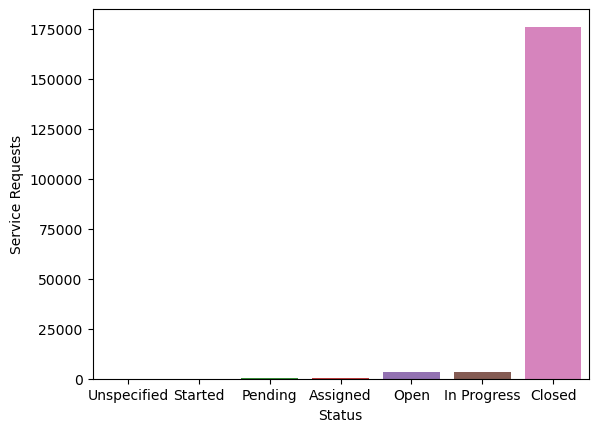

In [45]:
sns.barplot(x = 'Status', y = 'Service Requests',  data = status11226df)

In [46]:
status11226 = requests
status11226  = status11226.rename(columns={'Incident Zip': 'IncidentZip'})
values = [11226.0, 11207.0, 11208.0, 11221.0, 11201.0]
status11226 = status11226[status11226.IncidentZip.isin(values) == True]
status11226pv = status11226.pivot_table(index ='Location Type', values = 'Unique Key', aggfunc = 'count')
status11226pv = status11226pv.sort_values(by = 'Unique Key', ascending = True).tail(5)
status11226df = status11226pv.reset_index()
status11226df.rename(columns = {'Unique Key':'Service Requests'}, inplace = True)
status11226df.rename(columns = {'IncidentZip': 'Incident Zip'}, inplace = True)
status11226df

,Location Type,Service Requests
0,Sidewalk,8602
1,Street,14199
2,Residential Building/House,22944
3,RESIDENTIAL BUILDING,50406
4,Street/Sidewalk,50898


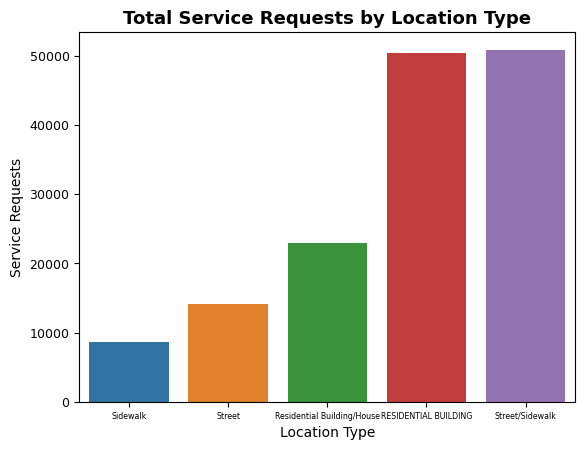

In [47]:
sns.barplot(x = 'Location Type', y = 'Service Requests',  data = status11226df)
plt.title('Total Service Requests by Location Type', fontsize=13, fontweight='bold')
plt.tick_params(axis='y', labelsize=9)
plt.tick_params(axis='x', labelsize=5.7)
plt.show()

# Service Requests Response Time

In [48]:
timediff = requests
timediff = timediff.rename(columns={'Incident Zip': 'IncidentZip'})

In [49]:
values = [11226.0, 11207.0, 11208.0, 11221.0, 11201.0]
timediff = status11226[status11226.IncidentZip.isin(values) == True]
timediff['Closed Date']= pd.to_datetime(timediff['Closed Date'])
timediff['Created Date']= pd.to_datetime(timediff['Created Date'])
timediff['New Created Date'] = timediff['Created Date'].dt.strftime("%Y-%m-%d")
timediff['New Closed Date'] = timediff['Closed Date'].dt.strftime("%Y-%m-%d")
timediff

,Unique Key,Created Date,Closed Date,Complaint Type,Descriptor,Location Type,IncidentZip,Status,Open Data Channel Type,Latitude,Longitude,Hour,Time of Day,Month,New Created Date,New Closed Date
0,53970157,2022-04-21 00:55:00,2023-01-12 00:00:00,General Construction/Plumbing,Sidewalk Shed/Pipe Scafford - Inadequate Defec...,NaN,11207,Closed,UNKNOWN,40.677434,-73.898880,0,AM,April,2022-04-21,2023-01-12
1,55337224,2022-09-08 08:46:00,2023-01-12 00:00:00,Building/Use,Illegal Conversion Of Residential Building/Space,NaN,11201,Closed,UNKNOWN,40.691776,-73.997245,8,AM,September,2022-09-08,2023-01-12
2,53983608,2022-04-22 11:22:00,2023-02-16 20:25:00,GENERAL,MAILBOX,RESIDENTIAL BUILDING,11221,Closed,PHONE,40.688590,-73.918256,11,AM,April,2022-04-22,2023-02-16
3,54034149,2022-04-28 14:23:00,2022-07-31 00:00:00,Traffic Signal Condition,Controller,NaN,11208,Closed,UNKNOWN,40.659414,-73.870791,14,PM,April,2022-04-28,2022-07-31
4,54158369,2022-05-13 13:32:00,2023-02-22 12:30:00,Uprooted Stump,Remove Stump,Street,11221,Closed,PHONE,40.684535,-73.939076,13,PM,May,2022-05-13,2023-02-22
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
183678,56410441,2022-12-31 12:41:00,2023-01-19 07:34:00,UNSANITARY CONDITION,GARBAGE/RECYCLING STORAGE,RESIDENTIAL BUILDING,11208,Closed,ONLINE,40.667408,-73.882635,12,PM,December,2022-12-31,2023-01-19
183679,56411923,2022-12-31 11:47:00,2023-01-23 20:31:00,PLUMBING,TOILET,RESIDENTIAL BUILDING,11221,Closed,ONLINE,40.684013,-73.943612,11,AM,December,2022-12-31,2023-01-23
183680,56411978,2022-12-31 05:16:00,2023-01-18 20:16:00,WATER LEAK,DAMP SPOT,RESIDENTIAL BUILDING,11221,Closed,ONLINE,40.690804,-73.943361,5,AM,December,2022-12-31,2023-01-18
183681,56412459,2022-12-31 08:37:00,2023-01-06 00:00:00,General Construction/Plumbing,Failure To Maintain,NaN,11207,Closed,UNKNOWN,40.677712,-73.885490,8,AM,December,2022-12-31,2023-01-06


In [50]:
timediff['New Created Date']= pd.to_datetime(timediff['New Created Date'])
timediff['New Closed Date']= pd.to_datetime(timediff['New Closed Date'])

In [51]:
timediff ['Response Time'] = timediff['New Closed Date'] - timediff['New Created Date']
timediff

,Unique Key,Created Date,Closed Date,Complaint Type,Descriptor,Location Type,IncidentZip,Status,Open Data Channel Type,Latitude,Longitude,Hour,Time of Day,Month,New Created Date,New Closed Date,Response Time
0,53970157,2022-04-21 00:55:00,2023-01-12 00:00:00,General Construction/Plumbing,Sidewalk Shed/Pipe Scafford - Inadequate Defec...,NaN,11207,Closed,UNKNOWN,40.677434,-73.898880,0,AM,April,2022-04-21,2023-01-12,266 days
1,55337224,2022-09-08 08:46:00,2023-01-12 00:00:00,Building/Use,Illegal Conversion Of Residential Building/Space,NaN,11201,Closed,UNKNOWN,40.691776,-73.997245,8,AM,September,2022-09-08,2023-01-12,126 days
2,53983608,2022-04-22 11:22:00,2023-02-16 20:25:00,GENERAL,MAILBOX,RESIDENTIAL BUILDING,11221,Closed,PHONE,40.688590,-73.918256,11,AM,April,2022-04-22,2023-02-16,300 days
3,54034149,2022-04-28 14:23:00,2022-07-31 00:00:00,Traffic Signal Condition,Controller,NaN,11208,Closed,UNKNOWN,40.659414,-73.870791,14,PM,April,2022-04-28,2022-07-31,94 days
4,54158369,2022-05-13 13:32:00,2023-02-22 12:30:00,Uprooted Stump,Remove Stump,Street,11221,Closed,PHONE,40.684535,-73.939076,13,PM,May,2022-05-13,2023-02-22,285 days
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
183678,56410441,2022-12-31 12:41:00,2023-01-19 07:34:00,UNSANITARY CONDITION,GARBAGE/RECYCLING STORAGE,RESIDENTIAL BUILDING,11208,Closed,ONLINE,40.667408,-73.882635,12,PM,December,2022-12-31,2023-01-19,19 days
183679,56411923,2022-12-31 11:47:00,2023-01-23 20:31:00,PLUMBING,TOILET,RESIDENTIAL BUILDING,11221,Closed,ONLINE,40.684013,-73.943612,11,AM,December,2022-12-31,2023-01-23,23 days
183680,56411978,2022-12-31 05:16:00,2023-01-18 20:16:00,WATER LEAK,DAMP SPOT,RESIDENTIAL BUILDING,11221,Closed,ONLINE,40.690804,-73.943361,5,AM,December,2022-12-31,2023-01-18,18 days
183681,56412459,2022-12-31 08:37:00,2023-01-06 00:00:00,General Construction/Plumbing,Failure To Maintain,NaN,11207,Closed,UNKNOWN,40.677712,-73.885490,8,AM,December,2022-12-31,2023-01-06,6 days


In [52]:
timediff['Response Time'] = timediff['Response Time'].astype(str)
timediff

,Unique Key,Created Date,Closed Date,Complaint Type,Descriptor,Location Type,IncidentZip,Status,Open Data Channel Type,Latitude,Longitude,Hour,Time of Day,Month,New Created Date,New Closed Date,Response Time
0,53970157,2022-04-21 00:55:00,2023-01-12 00:00:00,General Construction/Plumbing,Sidewalk Shed/Pipe Scafford - Inadequate Defec...,NaN,11207,Closed,UNKNOWN,40.677434,-73.898880,0,AM,April,2022-04-21,2023-01-12,266 days
1,55337224,2022-09-08 08:46:00,2023-01-12 00:00:00,Building/Use,Illegal Conversion Of Residential Building/Space,NaN,11201,Closed,UNKNOWN,40.691776,-73.997245,8,AM,September,2022-09-08,2023-01-12,126 days
2,53983608,2022-04-22 11:22:00,2023-02-16 20:25:00,GENERAL,MAILBOX,RESIDENTIAL BUILDING,11221,Closed,PHONE,40.688590,-73.918256,11,AM,April,2022-04-22,2023-02-16,300 days
3,54034149,2022-04-28 14:23:00,2022-07-31 00:00:00,Traffic Signal Condition,Controller,NaN,11208,Closed,UNKNOWN,40.659414,-73.870791,14,PM,April,2022-04-28,2022-07-31,94 days
4,54158369,2022-05-13 13:32:00,2023-02-22 12:30:00,Uprooted Stump,Remove Stump,Street,11221,Closed,PHONE,40.684535,-73.939076,13,PM,May,2022-05-13,2023-02-22,285 days
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
183678,56410441,2022-12-31 12:41:00,2023-01-19 07:34:00,UNSANITARY CONDITION,GARBAGE/RECYCLING STORAGE,RESIDENTIAL BUILDING,11208,Closed,ONLINE,40.667408,-73.882635,12,PM,December,2022-12-31,2023-01-19,19 days
183679,56411923,2022-12-31 11:47:00,2023-01-23 20:31:00,PLUMBING,TOILET,RESIDENTIAL BUILDING,11221,Closed,ONLINE,40.684013,-73.943612,11,AM,December,2022-12-31,2023-01-23,23 days
183680,56411978,2022-12-31 05:16:00,2023-01-18 20:16:00,WATER LEAK,DAMP SPOT,RESIDENTIAL BUILDING,11221,Closed,ONLINE,40.690804,-73.943361,5,AM,December,2022-12-31,2023-01-18,18 days
183681,56412459,2022-12-31 08:37:00,2023-01-06 00:00:00,General Construction/Plumbing,Failure To Maintain,NaN,11207,Closed,UNKNOWN,40.677712,-73.885490,8,AM,December,2022-12-31,2023-01-06,6 days


In [53]:
timediff['Response Time'] = timediff['Response Time'].str.replace('days', '')
timediff

,Unique Key,Created Date,Closed Date,Complaint Type,Descriptor,Location Type,IncidentZip,Status,Open Data Channel Type,Latitude,Longitude,Hour,Time of Day,Month,New Created Date,New Closed Date,Response Time
0,53970157,2022-04-21 00:55:00,2023-01-12 00:00:00,General Construction/Plumbing,Sidewalk Shed/Pipe Scafford - Inadequate Defec...,NaN,11207,Closed,UNKNOWN,40.677434,-73.898880,0,AM,April,2022-04-21,2023-01-12,266
1,55337224,2022-09-08 08:46:00,2023-01-12 00:00:00,Building/Use,Illegal Conversion Of Residential Building/Space,NaN,11201,Closed,UNKNOWN,40.691776,-73.997245,8,AM,September,2022-09-08,2023-01-12,126
2,53983608,2022-04-22 11:22:00,2023-02-16 20:25:00,GENERAL,MAILBOX,RESIDENTIAL BUILDING,11221,Closed,PHONE,40.688590,-73.918256,11,AM,April,2022-04-22,2023-02-16,300
3,54034149,2022-04-28 14:23:00,2022-07-31 00:00:00,Traffic Signal Condition,Controller,NaN,11208,Closed,UNKNOWN,40.659414,-73.870791,14,PM,April,2022-04-28,2022-07-31,94
4,54158369,2022-05-13 13:32:00,2023-02-22 12:30:00,Uprooted Stump,Remove Stump,Street,11221,Closed,PHONE,40.684535,-73.939076,13,PM,May,2022-05-13,2023-02-22,285
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
183678,56410441,2022-12-31 12:41:00,2023-01-19 07:34:00,UNSANITARY CONDITION,GARBAGE/RECYCLING STORAGE,RESIDENTIAL BUILDING,11208,Closed,ONLINE,40.667408,-73.882635,12,PM,December,2022-12-31,2023-01-19,19
183679,56411923,2022-12-31 11:47:00,2023-01-23 20:31:00,PLUMBING,TOILET,RESIDENTIAL BUILDING,11221,Closed,ONLINE,40.684013,-73.943612,11,AM,December,2022-12-31,2023-01-23,23
183680,56411978,2022-12-31 05:16:00,2023-01-18 20:16:00,WATER LEAK,DAMP SPOT,RESIDENTIAL BUILDING,11221,Closed,ONLINE,40.690804,-73.943361,5,AM,December,2022-12-31,2023-01-18,18
183681,56412459,2022-12-31 08:37:00,2023-01-06 00:00:00,General Construction/Plumbing,Failure To Maintain,NaN,11207,Closed,UNKNOWN,40.677712,-73.885490,8,AM,December,2022-12-31,2023-01-06,6


In [54]:
timediff.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 183670 entries, 0 to 183682
Data columns (total 17 columns):
 #   Column                  Non-Null Count   Dtype         
---  ------                  --------------   -----         
 0   Unique Key              183670 non-null  int64         
 1   Created Date            183670 non-null  datetime64[ns]
 2   Closed Date             176678 non-null  datetime64[ns]
 3   Complaint Type          183670 non-null  object        
 4   Descriptor              181148 non-null  object        
 5   Location Type           161629 non-null  object        
 6   IncidentZip             183670 non-null  int64         
 7   Status                  183670 non-null  object        
 8   Open Data Channel Type  183670 non-null  object        
 9   Latitude                182917 non-null  float64       
 10  Longitude               182917 non-null  float64       
 11  Hour                    183670 non-null  int64         
 12  Time of Day             183670

In [55]:
timediff.dropna()

,Unique Key,Created Date,Closed Date,Complaint Type,Descriptor,Location Type,IncidentZip,Status,Open Data Channel Type,Latitude,Longitude,Hour,Time of Day,Month,New Created Date,New Closed Date,Response Time
2,53983608,2022-04-22 11:22:00,2023-02-16 20:25:00,GENERAL,MAILBOX,RESIDENTIAL BUILDING,11221,Closed,PHONE,40.688590,-73.918256,11,AM,April,2022-04-22,2023-02-16,300
4,54158369,2022-05-13 13:32:00,2023-02-22 12:30:00,Uprooted Stump,Remove Stump,Street,11221,Closed,PHONE,40.684535,-73.939076,13,PM,May,2022-05-13,2023-02-22,285
5,54227181,2022-05-20 11:55:00,2023-02-27 12:06:00,Adopt-A-Basket,Adopt-A-Basket,Sidewalk,11226,Closed,PHONE,40.636040,-73.962241,11,AM,May,2022-05-20,2023-02-27,283
9,54603380,2022-06-26 00:01:00,2023-02-16 12:46:00,UNSANITARY CONDITION,GARBAGE/RECYCLING STORAGE,RESIDENTIAL BUILDING,11208,Closed,ONLINE,40.669575,-73.881478,0,AM,June,2022-06-26,2023-02-16,235
11,55184756,2022-08-23 13:19:00,2023-02-16 20:25:00,GENERAL,BELL/BUZZER/INTERCOM,RESIDENTIAL BUILDING,11221,Closed,PHONE,40.688590,-73.918256,13,PM,August,2022-08-23,2023-02-16,177
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
183675,56407341,2022-12-30 11:31:00,2023-01-23 07:29:00,PAINT/PLASTER,CEILING,RESIDENTIAL BUILDING,11221,Closed,PHONE,40.685129,-73.940413,11,AM,December,2022-12-30,2023-01-23,24
183677,56409934,2022-12-31 05:16:00,2023-01-18 20:16:00,UNSANITARY CONDITION,MOLD,RESIDENTIAL BUILDING,11221,Closed,ONLINE,40.690804,-73.943361,5,AM,December,2022-12-31,2023-01-18,18
183678,56410441,2022-12-31 12:41:00,2023-01-19 07:34:00,UNSANITARY CONDITION,GARBAGE/RECYCLING STORAGE,RESIDENTIAL BUILDING,11208,Closed,ONLINE,40.667408,-73.882635,12,PM,December,2022-12-31,2023-01-19,19
183679,56411923,2022-12-31 11:47:00,2023-01-23 20:31:00,PLUMBING,TOILET,RESIDENTIAL BUILDING,11221,Closed,ONLINE,40.684013,-73.943612,11,AM,December,2022-12-31,2023-01-23,23


In [56]:
timediff.rename(columns = {'Response Time':'ResponseTime'}, inplace = True)

In [57]:
values = ['NaT']
timediff = timediff[~timediff['ResponseTime'].isin(values)]
timediff['ResponseTime'] = timediff.loc[timediff['ResponseTime'] != 0, 'ResponseTime']

/var/folders/jn/1_kjk85d7bbg9x02j8p9_t3c0000gn/T/ipykernel_43061/2911003778.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [58]:
timediff

,Unique Key,Created Date,Closed Date,Complaint Type,Descriptor,Location Type,IncidentZip,Status,Open Data Channel Type,Latitude,Longitude,Hour,Time of Day,Month,New Created Date,New Closed Date,ResponseTime
0,53970157,2022-04-21 00:55:00,2023-01-12 00:00:00,General Construction/Plumbing,Sidewalk Shed/Pipe Scafford - Inadequate Defec...,NaN,11207,Closed,UNKNOWN,40.677434,-73.898880,0,AM,April,2022-04-21,2023-01-12,266
1,55337224,2022-09-08 08:46:00,2023-01-12 00:00:00,Building/Use,Illegal Conversion Of Residential Building/Space,NaN,11201,Closed,UNKNOWN,40.691776,-73.997245,8,AM,September,2022-09-08,2023-01-12,126
2,53983608,2022-04-22 11:22:00,2023-02-16 20:25:00,GENERAL,MAILBOX,RESIDENTIAL BUILDING,11221,Closed,PHONE,40.688590,-73.918256,11,AM,April,2022-04-22,2023-02-16,300
3,54034149,2022-04-28 14:23:00,2022-07-31 00:00:00,Traffic Signal Condition,Controller,NaN,11208,Closed,UNKNOWN,40.659414,-73.870791,14,PM,April,2022-04-28,2022-07-31,94
4,54158369,2022-05-13 13:32:00,2023-02-22 12:30:00,Uprooted Stump,Remove Stump,Street,11221,Closed,PHONE,40.684535,-73.939076,13,PM,May,2022-05-13,2023-02-22,285
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
183678,56410441,2022-12-31 12:41:00,2023-01-19 07:34:00,UNSANITARY CONDITION,GARBAGE/RECYCLING STORAGE,RESIDENTIAL BUILDING,11208,Closed,ONLINE,40.667408,-73.882635,12,PM,December,2022-12-31,2023-01-19,19
183679,56411923,2022-12-31 11:47:00,2023-01-23 20:31:00,PLUMBING,TOILET,RESIDENTIAL BUILDING,11221,Closed,ONLINE,40.684013,-73.943612,11,AM,December,2022-12-31,2023-01-23,23
183680,56411978,2022-12-31 05:16:00,2023-01-18 20:16:00,WATER LEAK,DAMP SPOT,RESIDENTIAL BUILDING,11221,Closed,ONLINE,40.690804,-73.943361,5,AM,December,2022-12-31,2023-01-18,18
183681,56412459,2022-12-31 08:37:00,2023-01-06 00:00:00,General Construction/Plumbing,Failure To Maintain,NaN,11207,Closed,UNKNOWN,40.677712,-73.885490,8,AM,December,2022-12-31,2023-01-06,6


In [59]:
timediff['ResponseTime'] = pd.to_numeric(timediff['ResponseTime'])
timediff.rename(columns = {'ResponseTime':'Response Time'}, inplace = True)
timediff

/var/folders/jn/1_kjk85d7bbg9x02j8p9_t3c0000gn/T/ipykernel_43061/3009344737.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/jn/1_kjk85d7bbg9x02j8p9_t3c0000gn/T/ipykernel_43061/3009344737.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,Unique Key,Created Date,Closed Date,Complaint Type,Descriptor,Location Type,IncidentZip,Status,Open Data Channel Type,Latitude,Longitude,Hour,Time of Day,Month,New Created Date,New Closed Date,Response Time
0,53970157,2022-04-21 00:55:00,2023-01-12 00:00:00,General Construction/Plumbing,Sidewalk Shed/Pipe Scafford - Inadequate Defec...,NaN,11207,Closed,UNKNOWN,40.677434,-73.898880,0,AM,April,2022-04-21,2023-01-12,266
1,55337224,2022-09-08 08:46:00,2023-01-12 00:00:00,Building/Use,Illegal Conversion Of Residential Building/Space,NaN,11201,Closed,UNKNOWN,40.691776,-73.997245,8,AM,September,2022-09-08,2023-01-12,126
2,53983608,2022-04-22 11:22:00,2023-02-16 20:25:00,GENERAL,MAILBOX,RESIDENTIAL BUILDING,11221,Closed,PHONE,40.688590,-73.918256,11,AM,April,2022-04-22,2023-02-16,300
3,54034149,2022-04-28 14:23:00,2022-07-31 00:00:00,Traffic Signal Condition,Controller,NaN,11208,Closed,UNKNOWN,40.659414,-73.870791,14,PM,April,2022-04-28,2022-07-31,94
4,54158369,2022-05-13 13:32:00,2023-02-22 12:30:00,Uprooted Stump,Remove Stump,Street,11221,Closed,PHONE,40.684535,-73.939076,13,PM,May,2022-05-13,2023-02-22,285
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
183678,56410441,2022-12-31 12:41:00,2023-01-19 07:34:00,UNSANITARY CONDITION,GARBAGE/RECYCLING STORAGE,RESIDENTIAL BUILDING,11208,Closed,ONLINE,40.667408,-73.882635,12,PM,December,2022-12-31,2023-01-19,19
183679,56411923,2022-12-31 11:47:00,2023-01-23 20:31:00,PLUMBING,TOILET,RESIDENTIAL BUILDING,11221,Closed,ONLINE,40.684013,-73.943612,11,AM,December,2022-12-31,2023-01-23,23
183680,56411978,2022-12-31 05:16:00,2023-01-18 20:16:00,WATER LEAK,DAMP SPOT,RESIDENTIAL BUILDING,11221,Closed,ONLINE,40.690804,-73.943361,5,AM,December,2022-12-31,2023-01-18,18
183681,56412459,2022-12-31 08:37:00,2023-01-06 00:00:00,General Construction/Plumbing,Failure To Maintain,NaN,11207,Closed,UNKNOWN,40.677712,-73.885490,8,AM,December,2022-12-31,2023-01-06,6


In [60]:
timediff['Response Time'] = timediff['Response Time'].astype(float)
timediff

/var/folders/jn/1_kjk85d7bbg9x02j8p9_t3c0000gn/T/ipykernel_43061/484886.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,Unique Key,Created Date,Closed Date,Complaint Type,Descriptor,Location Type,IncidentZip,Status,Open Data Channel Type,Latitude,Longitude,Hour,Time of Day,Month,New Created Date,New Closed Date,Response Time
0,53970157,2022-04-21 00:55:00,2023-01-12 00:00:00,General Construction/Plumbing,Sidewalk Shed/Pipe Scafford - Inadequate Defec...,NaN,11207,Closed,UNKNOWN,40.677434,-73.898880,0,AM,April,2022-04-21,2023-01-12,266.0
1,55337224,2022-09-08 08:46:00,2023-01-12 00:00:00,Building/Use,Illegal Conversion Of Residential Building/Space,NaN,11201,Closed,UNKNOWN,40.691776,-73.997245,8,AM,September,2022-09-08,2023-01-12,126.0
2,53983608,2022-04-22 11:22:00,2023-02-16 20:25:00,GENERAL,MAILBOX,RESIDENTIAL BUILDING,11221,Closed,PHONE,40.688590,-73.918256,11,AM,April,2022-04-22,2023-02-16,300.0
3,54034149,2022-04-28 14:23:00,2022-07-31 00:00:00,Traffic Signal Condition,Controller,NaN,11208,Closed,UNKNOWN,40.659414,-73.870791,14,PM,April,2022-04-28,2022-07-31,94.0
4,54158369,2022-05-13 13:32:00,2023-02-22 12:30:00,Uprooted Stump,Remove Stump,Street,11221,Closed,PHONE,40.684535,-73.939076,13,PM,May,2022-05-13,2023-02-22,285.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
183678,56410441,2022-12-31 12:41:00,2023-01-19 07:34:00,UNSANITARY CONDITION,GARBAGE/RECYCLING STORAGE,RESIDENTIAL BUILDING,11208,Closed,ONLINE,40.667408,-73.882635,12,PM,December,2022-12-31,2023-01-19,19.0
183679,56411923,2022-12-31 11:47:00,2023-01-23 20:31:00,PLUMBING,TOILET,RESIDENTIAL BUILDING,11221,Closed,ONLINE,40.684013,-73.943612,11,AM,December,2022-12-31,2023-01-23,23.0
183680,56411978,2022-12-31 05:16:00,2023-01-18 20:16:00,WATER LEAK,DAMP SPOT,RESIDENTIAL BUILDING,11221,Closed,ONLINE,40.690804,-73.943361,5,AM,December,2022-12-31,2023-01-18,18.0
183681,56412459,2022-12-31 08:37:00,2023-01-06 00:00:00,General Construction/Plumbing,Failure To Maintain,NaN,11207,Closed,UNKNOWN,40.677712,-73.885490,8,AM,December,2022-12-31,2023-01-06,6.0


In [61]:
timediffpv = timediff.pivot_table(index ='Response Time', values = 'Unique Key', aggfunc = 'count')
timediffpv = timediffpv.sort_values(by = 'Unique Key', ascending = True)
timediffdf = timediffpv.reset_index()
timediffdf = timediffdf.drop(index = (0))
timediffdf.rename(columns = {'Unique Key':'Service Requests'}, inplace = True)
timediffdf

,Response Time,Service Requests
1,331.0,1
2,330.0,1
3,321.0,1
4,317.0,1
5,315.0,1
...,...,...
362,4.0,6138
363,3.0,8328
364,2.0,10775
365,1.0,21053


In [62]:
# Define the interval ranges
intervals = [(0, 30), (31, 59), (60, 89), (90, 119), (120, 149), (150, 179), (180, 209), (210, 239), (240, 269), (270, 299), (300, 331)]  # Add more intervals as needed

# Create a new column 'Response Time Group' based on the interval ranges
timediffdf['Response Time Group'] = pd.cut(timediffdf['Response Time'], 
                                          bins=[interval[0]-1 for interval in intervals] + [intervals[-1][1]],
                                          labels=['{}-{}'.format(interval[0], interval[1]) for interval in intervals])

# Group by the 'Response Time Group' and sum the 'Service Requests' column
grouped_df = timediffdf.groupby('Response Time Group')['Service Requests'].sum()

# Create a new DataFrame from the grouped data
grouped_timediffdf = pd.DataFrame({'Response Time Group': grouped_df.index, 'Service Requests': grouped_df.values})

# Sort the DataFrame by 'Service Requests' in ascending order
grouped_timediffdf = grouped_timediffdf.sort_values(by='Service Requests', ascending=True)

# Reset the index of the DataFrame
grouped_timediffdf = grouped_timediffdf.reset_index(drop=True)

# Display the modified DataFrame
print(grouped_timediffdf)


   Response Time Group  Service Requests
0              300-331                38
1              270-299                77
2              210-239               159
3              240-269               159
4              180-209               431
5              150-179               644
6              120-149               774
7               90-119              1246
8                60-89              2666
9                31-59              6269
10                0-30            163935


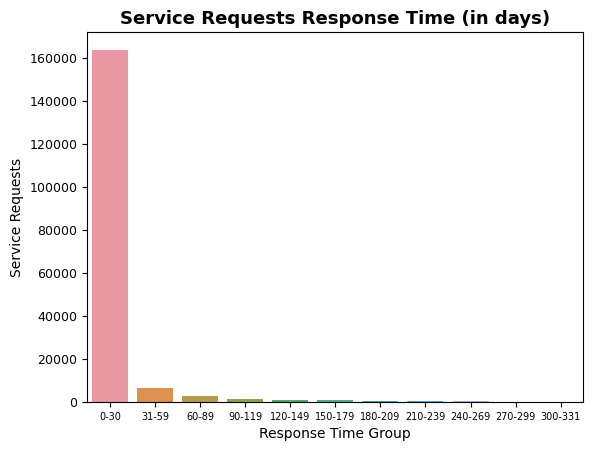

In [63]:
sns.barplot(x = 'Response Time Group', y = 'Service Requests',  data = grouped_timediffdf)
plt.title('Service Requests Response Time (in days)', fontsize=13, fontweight='bold')
plt.tick_params(axis='x', labelsize=7)
plt.tick_params(axis='y', labelsize=9)
plt.show()

<AxesSubplot:xlabel='Response Time', ylabel='Count'>

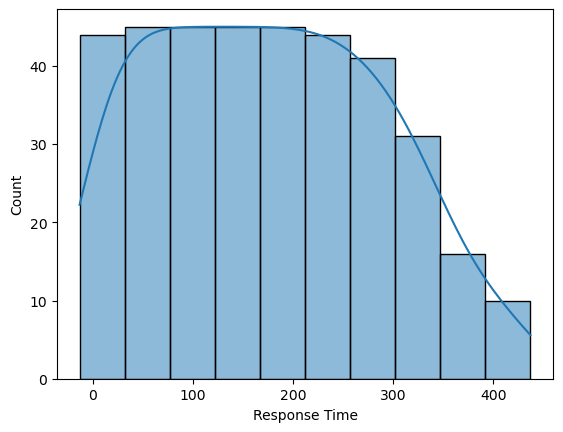

In [64]:
sns.histplot(data = timediffdf, x = 'Response Time', kde = True)

In [65]:
mean = timediff['Response Time'].mean()
mean

8.573551885350751

In [66]:
data = timediff.pivot_table(index ='IncidentZip', values = 'Response Time')
data = data.sort_values(by = 'Response Time', ascending = True)
average_response_time_df = data.groupby('IncidentZip')['Response Time'].mean().reset_index()
print(average_response_time_df)


   IncidentZip  Response Time
0        11201       6.277145
1        11207       9.139980
2        11208       9.067473
3        11221       7.796570
4        11226       9.697546


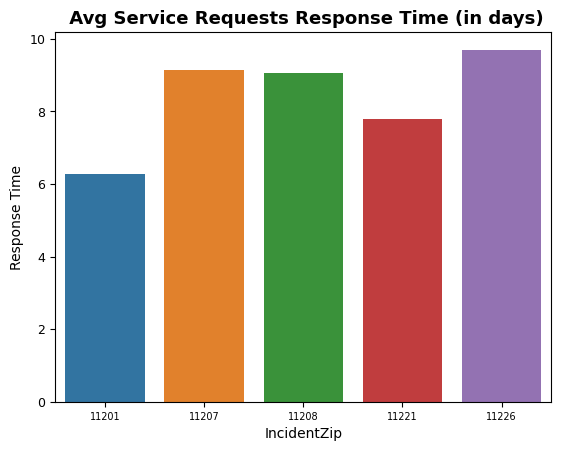

In [67]:
sns.barplot(x = 'IncidentZip', y = 'Response Time',  data = average_response_time_df)
plt.title(' Avg Service Requests Response Time (in days)', fontsize=13, fontweight='bold')
plt.tick_params(axis='x', labelsize=7)
plt.tick_params(axis='y', labelsize=9)
plt.show()

In [68]:
complainttime = timediff.pivot_table(index ='Complaint Type', values = 'Response Time')
complainttime = complainttime.sort_values(by = 'Response Time', ascending = True)
avg_response_complaint_df = complainttime.groupby('Complaint Type')['Response Time'].mean().reset_index()
avg_response_complaint_df = avg_response_complaint_df.sort_values(by='Response Time', ascending=True).tail(10)
print(avg_response_complaint_df)

                    Complaint Type  Response Time
4                   Adopt-A-Basket      58.666667
49      For Hire Vehicle Complaint      61.129952
31                 Dead/Dying Tree      72.146341
68                   Indoor Sewage      73.000000
20                    Building/Use      88.358377
83                New Tree Request     103.323404
53                        Graffiti     131.695594
78                   Lot Condition     153.010417
112  Root/Sewer/Sidewalk Condition     209.724490
137                 Uprooted Stump     248.200000


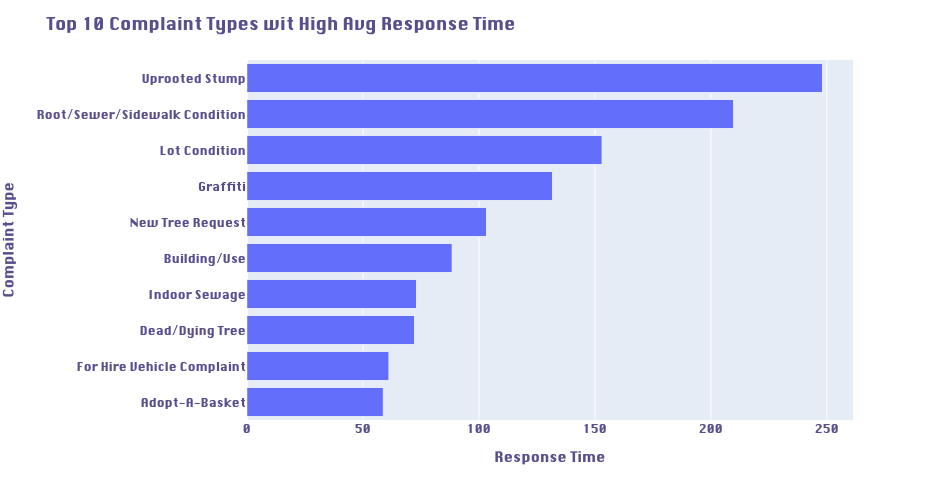

In [69]:
avg_response_complaint_df_fig = px.bar(avg_response_complaint_df, x="Response Time", y="Complaint Type", 
             orientation='h', height=500)

avg_response_complaint_df_fig.update_layout(hovermode='x', title=" Top 10 Complaint Types wit High Avg Response Time ",
                  font=dict(family="silom", size=12, color="#58508d"))

avg_response_complaint_df_fig.show()

In [70]:
bottomcomplainttime= timediff.pivot_table(index ='Complaint Type', values = 'Response Time')
bottomcomplainttime = bottomcomplainttime.sort_values(by = 'Response Time', ascending = True).head(10)
bottom_avg_response_complaint_df = complainttime.groupby('Complaint Type')['Response Time'].mean().reset_index()
bottom_avg_response_complaint_df = bottom_avg_response_complaint_df.sort_values(by='Response Time', ascending=True).head(10)
print(bottom_avg_response_complaint_df)

                 Complaint Type  Response Time
58   Homeless Person Assistance      -8.502283
101                       Plant       0.000000
82                   Mosquitoes       0.000000
100                    Pet Shop       0.000000
60          Illegal Animal Sold       0.000000
122              Standing Water       0.000000
59   Illegal Animal Kept as Pet       0.000000
34             Disorderly Youth       0.000000
134  Unsanitary Animal Facility       0.000000
133               Unleashed Dog       0.000000


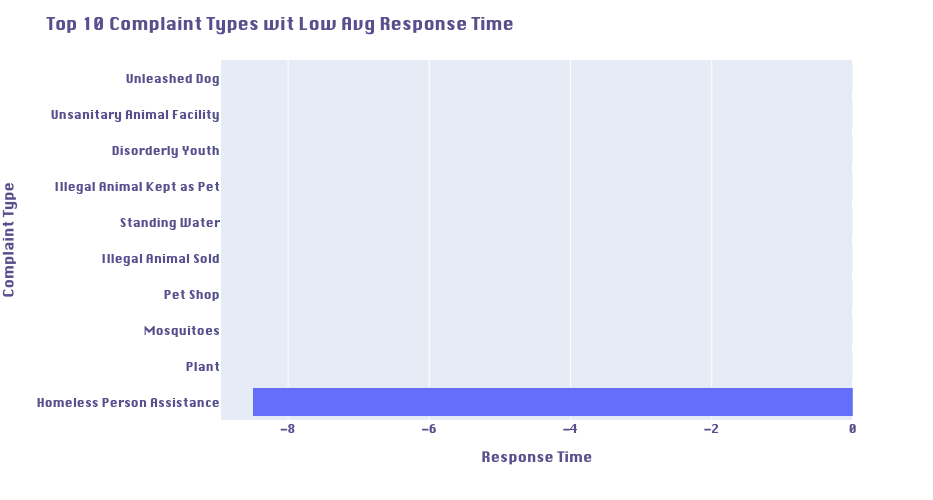

In [71]:
bottom_avg_response_complaint_df_fig = px.bar(bottom_avg_response_complaint_df, x="Response Time", y="Complaint Type", 
             orientation='h', height=500)

bottom_avg_response_complaint_df_fig.update_layout(hovermode='x', title="Top 10 Complaint Types wit Low Avg Response Time",
                  font=dict(family="silom", size=12, color="#58508d"))

bottom_avg_response_complaint_df_fig.show()

In [72]:
bottomcomplainttime = timediff.pivot_table(index='Complaint Type', values='Response Time')
bottomcomplainttime = bottomcomplainttime.sort_values(by='Response Time', ascending=True)
bottom_avg_response_complaint_df = bottomcomplainttime['Response Time'].reset_index()
bottom_avg_response_complaint_df = bottom_avg_response_complaint_df.sort_values(by='Response Time', ascending=True)

pd.set_option('display.max_rows', None)
print(bottom_avg_response_complaint_df)

                              Complaint Type  Response Time
0                 Homeless Person Assistance      -8.502283
1                                      Plant       0.000000
2                                 Mosquitoes       0.000000
3                                   Pet Shop       0.000000
4                        Illegal Animal Sold       0.000000
5                             Standing Water       0.000000
6                 Illegal Animal Kept as Pet       0.000000
7                           Disorderly Youth       0.000000
8                 Unsanitary Animal Facility       0.000000
9                              Unleashed Dog       0.000000
10               Animal Facility - No Permit       0.000000
11                               Panhandling       0.006803
12                         Abandoned Vehicle       0.030900
13                  Noise - House of Worship       0.046875
14                              Animal-Abuse       0.050459
15               Non-Emergency Police Ma

# Machine Learning : Estimating Response Time per Zip Code and Complaint Type

In [73]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer

X = timediff[['IncidentZip', 'Complaint Type']]
y = timediff['Response Time']

# Perform one-hot encoding on the 'Complaint Type' column
ct = ColumnTransformer([('encoder', OneHotEncoder(), [1])], remainder='passthrough')
X_encoded = ct.fit_transform(X)

model = DecisionTreeRegressor()
model.fit(X_encoded, y)

# Perform one-hot encoding on the new data points for prediction
new_data = [[11226, 'Taxi Complaint'],
            [11201, 'Uprooted Stump'],
            [11207, 'Illegal Tree Damage'],
            [11226, 'Urinating in Public']]

new_data_encoded = ct.transform(new_data)

predictions = model.predict(new_data_encoded)

print(predictions)

[2.20000000e+01 3.48000000e+02 1.23478261e+01 1.66666667e-01]


/Users/mariannabeaute/opt/anaconda3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning:

X does not have valid feature names, but OneHotEncoder was fitted with feature names



In [74]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

In [75]:
# Define the categorical feature columns
categorical_cols = ['Complaint Type']

# Perform one-hot encoding on the categorical features
ct = ColumnTransformer([('encoder', OneHotEncoder(), categorical_cols)], remainder='passthrough')
X_encoded = ct.fit_transform(X)

# Split the input and output sets into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X_encoded, y, test_size=0.2, random_state=42)

# Select and fit the model
model = DecisionTreeClassifier()
model.fit(X_train, y_train)

# Make predictions
predictions = model.predict(X_test)

# Evaluate the model
score = accuracy_score(y_test, predictions)
print("Accuracy Score: ", score)


Accuracy Score:  0.5248754810957663
